In [1]:
import os
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import itertools
import collections
import numpy as np
import json
import tweepy as tw
import nltk
import matplotlib.cm as cm
from nltk.corpus import stopwords
from nltk import bigrams
import re
import networkx as nx
import igraph
import warnings
import community as community_louvain
warnings.filterwarnings("ignore")

In [2]:
data_edge=pd.read_csv("./edge.csv")
data_edge

,source,target,weight,ifmis
0,0,1894,1,1
1,0,3054,1,1
2,0,2376,1,1
3,0,3807,1,1
4,0,6269,1,1
...,...,...,...,...
29685,8803,7110,1,0
29686,8804,8490,1,0
29687,8805,6347,1,0
29688,8806,404,1,1


In [4]:
data_node=pd.read_csv("./node.csv")
data_node

,name,lable
0,0,1
1,1,1
2,2,1
3,3,1
4,4,0
...,...,...
8803,8803,0
8804,8804,0
8805,8805,0
8806,8806,1


In [5]:
G = igraph.Graph.DataFrame(data_edge, directed=False,vertices = data_node)
igraph.summary(G)

IGRAPH UNW- 8808 29690 -- 
+ attr: lable (v), name (v), ifmis (e), weight (e)


In [9]:
G = igraph.Graph.DataFrame(data_edge, directed=False,vertices = data_node)
def getValue(value):
    colorList = ['blue','green','purple','yellow','red','pink','orange','black','white','gray','brown','wheat']
    return colorList[int(value)]

visual_style = dict()
visual_style['vertex_size']=6
visual_style['edge_width=']=0.001
visual_style['vertex_color'] = list(map(getValue, (G.vs['lable'])))
visual_style['bbox'] = [0, 0, 450, 450]

igraph.plot(G, **visual_style)

In [12]:
closeness = G.closeness()
max(closeness)


0.30463507436873055

In [18]:
G=nx.from_pandas_edgelist(data_edge, 'source', 'target', ["weight","ifmis"],create_using = nx.DiGraph())

In [19]:
print("Number of g nodes:",G.number_of_nodes())
print("Number of g edges:",G.size())

Number of g nodes: 8808
Number of g edges: 29690


In [20]:
nx.degree_histogram(G)

[0,
 0,
 2856,
 1153,
 1127,
 717,
 538,
 429,
 296,
 244,
 206,
 163,
 129,
 117,
 81,
 104,
 61,
 53,
 46,
 43,
 33,
 27,
 29,
 30,
 15,
 24,
 17,
 19,
 15,
 14,
 13,
 11,
 13,
 9,
 4,
 8,
 7,
 10,
 4,
 9,
 4,
 4,
 8,
 3,
 6,
 7,
 3,
 1,
 3,
 1,
 6,
 3,
 3,
 1,
 3,
 4,
 1,
 1,
 3,
 2,
 0,
 0,
 3,
 0,
 1,
 1,
 2,
 2,
 0,
 3,
 1,
 1,
 6,
 1,
 1,
 0,
 1,
 2,
 2,
 1,
 1,
 2,
 3,
 1,
 0,
 0,
 0,
 0,
 3,
 0,
 1,
 2,
 0,
 0,
 0,
 0,
 1,
 0,
 1,
 0,
 1,
 0,
 0,
 1,
 2,
 1,
 1,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 1,
 0,
 1,
 1,
 0,
 1,
 0,
 0,
 0,
 0,
 1,
 0,
 0,
 0,
 0,
 1,
 0,
 0,
 0,
 1,
 0,
 1,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 1,
 0,
 0,
 0,
 1,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 1,
 1,
 0,
 0,
 0,
 0,
 1,
 0,
 0,
 0,
 0,
 1,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 1,
 1,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 1,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 1]

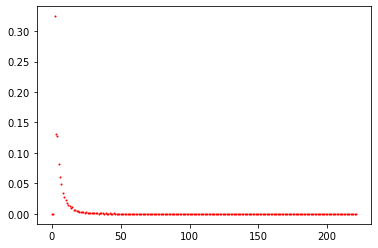

222

In [29]:
G_degree =  nx.degree_histogram(G)          #返回图中所有节点的度分布序列
x=range(len(G_degree))#生成X轴序列，从1到最大度
y=[z/(8807) for z in G_degree]#将频次转化为频率，利用列表内涵
plt.scatter(x,y,s=1,color=(1,0,0))#在双对坐标轴上绘制度分布曲线
plt.show()#显示图表                                         
len(G_degree)

In [24]:
betweenness=nx.betweenness_centrality(G)

In [25]:
for k, v in betweenness.items():
    if v == max(betweenness.values()):
        class_1 = k
print("max key:",class_1)
print("max value:",max(betweenness.values()))

max key: 2780
max value: 0.09681696917372747


In [31]:
g = nx.from_pandas_edgelist(data_edge, 'source', 'target', ['weight','ifmis'])

In [32]:
node=data_node.name.tolist()
node_lable=data_node.lable.tolist()
dic_node = {node[i]:node_lable[i] for i in range(len(node))}

In [33]:
nx.set_node_attributes(g, dic_node, "ismis")

In [34]:
print("Number of g nodes:",g.number_of_nodes())
print("Number of g edges:",g.size())

Number of g nodes: 8808
Number of g edges: 25880


# Community Detection

# Non-overlapping 
## Louvain

In [37]:
partition1 = community_louvain.best_partition(g)
df1=pd.DataFrame.from_dict(list(partition1.items()))
new_col = ['name', 'Louvain_lable']
df1.columns = new_col
df1.sort_values(by='name',inplace=True)
data_node = pd.merge(data_node,df1,on='name',how='outer')
print("Cluster number of g:",1+max(partition1.values()))

Cluster number of g: 59


## EdMot

In [38]:
from karateclub import EdMot
EdMot_g = EdMot()
EdMot_g.fit(g)
partition3 = EdMot_g.get_memberships()
print("Cluster number of g:",1+max(partition3.values()))

Cluster number of g: 94


In [39]:
df3=pd.DataFrame.from_dict(list(partition3.items()))
new_col = ['name', 'EdMot_lable']
df3.columns = new_col
df3.sort_values(by='name',inplace=True)
data_node = pd.merge(data_node,df3,on='name',how='outer')
data_node

,name,lable,Louvain_lable,EdMot_lable
0,0,1,51,0
1,1,1,4,33
2,2,1,4,33
3,3,1,5,8
4,4,0,6,9
...,...,...,...,...
8803,8803,0,12,14
8804,8804,0,37,29
8805,8805,0,13,16
8806,8806,1,29,71


## SCD 

In [40]:
from karateclub import SCD
SCD_g = SCD()
SCD_g.fit(g)
partition4= SCD_g.get_memberships()
print("Cluster number of g:",1+max(partition4.values()))
df4=pd.DataFrame.from_dict(list(partition4.items()))
new_col = ['name', 'SCD_lable']
df4.columns = new_col
df4.sort_values(by='name',inplace=True)
data_node = pd.merge(data_node,df4,on='name',how='outer')
data_node

Cluster number of g: 4920


,name,lable,Louvain_lable,EdMot_lable,SCD_lable
0,0,1,51,0,1527
1,1,1,4,33,919
2,2,1,4,33,888
3,3,1,5,8,4830
4,4,0,6,9,174
...,...,...,...,...,...
8803,8803,0,12,14,1568
8804,8804,0,37,29,1562
8805,8805,0,13,16,1842
8806,8806,1,29,71,4543


## LabelPropagation

In [41]:
from karateclub import LabelPropagation
LabelPropagation_g = LabelPropagation()
LabelPropagation_g.fit(g)
partition5 = LabelPropagation_g.get_memberships()
df5=pd.DataFrame.from_dict(list(partition5.items()))
new_col = ['name', 'LabelPropagation_lable']
df5.columns = new_col
df5.sort_values(by='name',inplace=True)
data_node = pd.merge(data_node,df5,on='name',how='outer')
data_node

,name,lable,Louvain_lable,EdMot_lable,SCD_lable,LabelPropagation_lable
0,0,1,51,0,1527,266
1,1,1,4,33,919,266
2,2,1,4,33,888,266
3,3,1,5,8,4830,266
4,4,0,6,9,174,6195
...,...,...,...,...,...,...
8803,8803,0,12,14,1568,266
8804,8804,0,37,29,1562,8800
8805,8805,0,13,16,1842,266
8806,8806,1,29,71,4543,677


In [63]:
print("Cluster number of g:",1+max(partition5.values()))

Cluster number of g: 8801


## GEMSEC

In [42]:
from karateclub import GEMSEC
GEMSEC_g = GEMSEC()
GEMSEC_g.fit(g)
partition2 = GEMSEC_g.get_memberships()

print("Cluster number of g:",1+max(partition2.values()))
df2=pd.DataFrame.from_dict(list(partition2.items()))
new_col = ['name', 'GEMSEC_lable']
df2.columns = new_col
df2.sort_values(by='name',inplace=True)
data_node = pd.merge(data_node,df2,on='name',how='outer')
data_node

Cluster number of g: 10


,name,lable,Louvain_lable,EdMot_lable,SCD_lable,LabelPropagation_lable,GEMSEC_lable
0,0,1,51,0,1527,266,5
1,1,1,4,33,919,266,0
2,2,1,4,33,888,266,5
3,3,1,5,8,4830,266,5
4,4,0,6,9,174,6195,5
...,...,...,...,...,...,...,...
8803,8803,0,12,14,1568,266,5
8804,8804,0,37,29,1562,8800,5
8805,8805,0,13,16,1842,266,5
8806,8806,1,29,71,4543,677,5


In [44]:
data_node.to_csv("./node_lable.csv",index=False)

# Overlapping
## EgoNetSplitter

In [45]:
from karateclub import EgoNetSplitter
EgoNetSplitter_g = EgoNetSplitter()
EgoNetSplitter_g.fit(g)
partition6 = EgoNetSplitter_g.get_memberships()

num_cluster =[]
for i in partition6.values():
    num_cluster.append(len(i))
max_num_cluster=max(num_cluster)
res=max([max(i) for i in partition6.values()])
print("The maximum number of overlapping communities is :",max_num_cluster)
print("Cluster number of g is :",res-1)
partition6_1={}
for key,value in partition6.items():
       partition6_1.update({key: value[0]})

df6=pd.DataFrame.from_dict(list(partition6_1.items()))
new_col = ['name', 'EgoNetSplitter_lable']
df6.columns = new_col
df6.sort_values(by='name',inplace=True)
data_node = pd.merge(data_node,df6,on='name',how='outer')
data_node

The maximum number of overlapping communities is : 1
Cluster number of g is : 88


,name,lable,Louvain_lable,EdMot_lable,SCD_lable,LabelPropagation_lable,GEMSEC_lable,EgoNetSplitter_lable
0,0,1,51,0,1527,266,5,0
1,1,1,4,33,919,266,0,19
2,2,1,4,33,888,266,5,21
3,3,1,5,8,4830,266,5,43
4,4,0,6,9,174,6195,5,30
...,...,...,...,...,...,...,...,...
8803,8803,0,12,14,1568,266,5,10
8804,8804,0,37,29,1562,8800,5,34
8805,8805,0,13,16,1842,266,5,40
8806,8806,1,29,71,4543,677,5,50


## DANMF

In [50]:
from karateclub import DANMF
DANMF_g = DANMF()
DANMF_g.fit(g)
partition7 = DANMF_g.get_memberships()
print("Cluster number of g:",1+max(partition7.values()))
df7=pd.DataFrame.from_dict(list(partition7.items()))
new_col = ['name', 'DANMF_lable']
df7.columns = new_col
df7.sort_values(by='name',inplace=True)
data_node = pd.merge(data_node,df7,on='name',how='outer')

Cluster number of g: 8


In [52]:
data_node.to_csv("./node_lable.csv",index=False)

## NNSED

In [46]:
from karateclub import NNSED
NNSED_g = NNSED()
NNSED_g.fit(g)
partition8 = NNSED_g.get_memberships()
print("Cluster number of g:",1+max(partition8.values()))
df8=pd.DataFrame.from_dict(list(partition8.items()))
new_col = ['name', 'NNSED_lable']
df8.columns = new_col
df8.sort_values(by='name',inplace=True)
data_node = pd.merge(data_node,df8,on='name',how='outer')
data_node

Cluster number of g: 32


,name,lable,Louvain_lable,EdMot_lable,SCD_lable,LabelPropagation_lable,GEMSEC_lable,EgoNetSplitter_lable,NNSED_lable
0,0,1,51,0,1527,266,5,0,27
1,1,1,4,33,919,266,0,19,3
2,2,1,4,33,888,266,5,21,3
3,3,1,5,8,4830,266,5,43,16
4,4,0,6,9,174,6195,5,30,6
...,...,...,...,...,...,...,...,...,...
8803,8803,0,12,14,1568,266,5,10,6
8804,8804,0,37,29,1562,8800,5,34,0
8805,8805,0,13,16,1842,266,5,40,15
8806,8806,1,29,71,4543,677,5,50,15


## MNMF

In [47]:
from karateclub import MNMF
MNMF_g = MNMF()
MNMF_g.fit(g)
partition9 = MNMF_g.get_memberships()
print("Cluster number of g:",1+max(partition9.values()))
df9=pd.DataFrame.from_dict(list(partition9.items()))
new_col = ['name', 'MNMF_lable']
df9.columns = new_col
df9.sort_values(by='name',inplace=True)
data_node = pd.merge(data_node,df9,on='name',how='outer')

Cluster number of g: 10


## BigClam

In [48]:
from karateclub import BigClam
BigClam_g = BigClam()
BigClam_g.fit(g)
partition10 = BigClam_g.get_memberships()
print("Cluster number of g:",1+max(partition10.values()))
df10=pd.DataFrame.from_dict(list(partition10.items()))
new_col = ['name', 'BigClam_lable']
df10.columns = new_col
df10.sort_values(by='name',inplace=True)
data_node = pd.merge(data_node,df10,on='name',how='outer')
data_node

Cluster number of g: 1


,name,lable,Louvain_lable,EdMot_lable,SCD_lable,LabelPropagation_lable,GEMSEC_lable,EgoNetSplitter_lable,NNSED_lable,MNMF_lable,BigClam_lable
0,0,1,51,0,1527,266,5,0,27,7,0
1,1,1,4,33,919,266,0,19,3,5,0
2,2,1,4,33,888,266,5,21,3,3,0
3,3,1,5,8,4830,266,5,43,16,9,0
4,4,0,6,9,174,6195,5,30,6,6,0
...,...,...,...,...,...,...,...,...,...,...,...
8803,8803,0,12,14,1568,266,5,10,6,0,0
8804,8804,0,37,29,1562,8800,5,34,0,8,0
8805,8805,0,13,16,1842,266,5,40,15,8,0
8806,8806,1,29,71,4543,677,5,50,15,4,0


## SymmNMF


In [49]:
from karateclub import SymmNMF
SymmNMF_g =SymmNMF()
SymmNMF_g.fit(g)
partition11 = SymmNMF_g.get_memberships()
print("Cluster number of g:",1+max(partition11.values()))
df11=pd.DataFrame.from_dict(list(partition11.items()))
new_col = ['name', 'SymmNMF_lable']
df11.columns = new_col
df11.sort_values(by='name',inplace=True)
data_node = pd.merge(data_node,df11,on='name',how='outer')
data_node

Cluster number of g: 32


,name,lable,Louvain_lable,EdMot_lable,SCD_lable,LabelPropagation_lable,GEMSEC_lable,EgoNetSplitter_lable,NNSED_lable,MNMF_lable,BigClam_lable,SymmNMF_lable
0,0,1,51,0,1527,266,5,0,27,7,0,5
1,1,1,4,33,919,266,0,19,3,5,0,9
2,2,1,4,33,888,266,5,21,3,3,0,9
3,3,1,5,8,4830,266,5,43,16,9,0,22
4,4,0,6,9,174,6195,5,30,6,6,0,26
...,...,...,...,...,...,...,...,...,...,...,...,...
8803,8803,0,12,14,1568,266,5,10,6,0,0,19
8804,8804,0,37,29,1562,8800,5,34,0,8,0,26
8805,8805,0,13,16,1842,266,5,40,15,8,0,20
8806,8806,1,29,71,4543,677,5,50,15,4,0,13


In [53]:

import community
print("Louvain Modularity:",community.modularity(partition1,g))
print("GEMSEC Modularity:",community.modularity(partition2,g))
print("EdMot Modularity:",community.modularity(partition3,g))
print("SCD Modularity:",community.modularity(partition4,g))
print("LabelPropagation Modularity:",community.modularity(partition5,g))

print("EgoNetSplittern Modularity:",community.modularity(partition6_1,g))
print("DANMF Modularity:",community.modularity(partition7,g))
print("NNSED Modularity:",community.modularity(partition8,g))
print("MNMF Modularity:",community.modularity(partition9,g))
print("BigClam Modularity:",community.modularity(partition10,g))
print("SymmNMF:",community.modularity(partition11,g))

Louvain Modularity: 0.7297682133956555
GEMSEC Modularity: 0.19033328895161505
EdMot Modularity: 0.734339426473329
SCD Modularity: 0.3681604925430947
LabelPropagation Modularity: 0.5007641845799118
EgoNetSplittern Modularity: 0.7345059923151744
DANMF Modularity: 0.3914326995101825
NNSED Modularity: 0.323621156608464
MNMF Modularity: 0.6137350013549476
BigClam Modularity: 0.0
SymmNMF: 0.3303615201104009


In [54]:
from sklearn.metrics import accuracy_score
import numpy as np

def purity_score(y_true, y_pred):
    """Purity score
        Args:
            y_true(np.ndarray): n*1 matrix Ground truth labels
            y_pred(np.ndarray): n*1 matrix Predicted clusters

        Returns:
            float: Purity score
    """
    # matrix which will hold the majority-voted labels
    y_voted_labels = np.zeros(y_true.shape)
    # Ordering labels
    ## Labels might be missing e.g with set like 0,2 where 1 is missing
    ## First find the unique labels, then map the labels to an ordered set
    ## 0,2 should become 0,1
    labels = np.unique(y_true)
    ordered_labels = np.arange(labels.shape[0])
    for k in range(labels.shape[0]):
        y_true[y_true==labels[k]] = ordered_labels[k]
    # Update unique labels
    labels = np.unique(y_true)
    # We set the number of bins to be n_classes+2 so that 
    # we count the actual occurence of classes between two consecutive bins
    # the bigger being excluded [bin_i, bin_i+1[
    bins = np.concatenate((labels, [np.max(labels)+1]), axis=0)

    for cluster in np.unique(y_pred):
        hist, _ = np.histogram(y_true[y_pred==cluster], bins=bins)
        # Find the most present label in the cluster
        winner = np.argmax(hist)
        y_voted_labels[y_pred==cluster] = winner

    return accuracy_score(y_true, y_voted_labels)

print("Louvain Purity:",purity_score(data_node.lable.values,data_node.Louvain_lable.values))
print("EdMot Purity:",purity_score(data_node.lable.values,data_node.EdMot_lable.values))
print("SCD Purity:",purity_score(data_node.lable.values,data_node.SCD_lable.values))
print("LabelPropagation Purity:",purity_score(data_node.lable.values,data_node.LabelPropagation_lable.values))
print("GEMSEC Purity:",purity_score(data_node.lable.values,data_node.GEMSEC_lable.values))

print("DANMF Purity::",purity_score(data_node.lable.values,data_node.DANMF_lable.values))
print("NNSED Modularity:",purity_score(data_node.lable.values,data_node.NNSED_lable.values))
print("MNMF Modularity:",purity_score(data_node.lable.values,data_node.MNMF_lable.values))
print("EgoNetSplittern Purity::",purity_score(data_node.lable.values,data_node.EgoNetSplitter_lable.values))
print("BigClam  Purity::",purity_score(data_node.lable.values,data_node.BigClam_lable.values))
print("SymmNMF  Purity::",purity_score(data_node.lable.values,data_node.SymmNMF_lable.values))

Louvain Purity: 0.7685059037238874
EdMot Purity: 0.7708900999091735
SCD Purity: 0.915985467756585
LabelPropagation Purity: 0.7741825613079019
GEMSEC Purity: 0.5675522252497729
DANMF Purity:: 0.6977747502270663
NNSED Modularity: 0.6696185286103542
MNMF Modularity: 0.6449818346957311
EgoNetSplittern Purity:: 0.7745231607629428
BigClam  Purity:: 0.546094459582198
SymmNMF  Purity:: 0.6841507720254314


In [55]:
import math
from sklearn import metrics
def NMI(A,B):
    # 样本点数
    total = len(A)
    A_ids = set(A)
    B_ids = set(B)
    # 互信息计算
    MI = 0
    eps = 1.4e-45
    for idA in A_ids:
        for idB in B_ids:
            idAOccur = np.where(A==idA)    # 输出满足条件的元素的下标
            idBOccur = np.where(B==idB)
            idABOccur = np.intersect1d(idAOccur,idBOccur)   # Find the intersection of two arrays.
            px = 1.0*len(idAOccur[0])/total
            py = 1.0*len(idBOccur[0])/total
            pxy = 1.0*len(idABOccur)/total
            MI = MI + pxy*math.log(pxy/(px*py)+eps,2)
    # 标准化互信息
    Hx = 0
    for idA in A_ids:
        idAOccurCount = 1.0*len(np.where(A==idA)[0])
        Hx = Hx - (idAOccurCount/total)*math.log(idAOccurCount/total+eps,2)
        Hy = 0
    for idB in B_ids:
        idBOccurCount = 1.0*len(np.where(B==idB)[0])
        Hy = Hy - (idBOccurCount/total)*math.log(idBOccurCount/total+eps,2)
    MIhat = 2.0*MI/(Hx+Hy)
    return MIhat
 
print("Louvain NMI:",NMI(data_node.lable.values,data_node.Louvain_lable.values))
print("EdMot NMI:",NMI(data_node.lable.values,data_node.EdMot_lable.values))
print("SCD NMI:",NMI(data_node.lable.values,data_node.SCD_lable.values))
print("LabelPropagation NMI:",NMI(data_node.lable.values,data_node.LabelPropagation_lable.values))
print("GEMSEC NMI:",NMI(data_node.lable.values,data_node.GEMSEC_lable.values))
print("DANMF NMI:",NMI(data_node.lable.values,data_node.DANMF_lable.values))
print("NNSED Modularity:",NMI(data_node.lable.values,data_node.NNSED_lable.values))
print("MNMF Modularity:",NMI(data_node.lable.values,data_node.MNMF_lable.values))
print("EgoNetSplitter NMI:",NMI(data_node.lable.values,data_node.EgoNetSplitter_lable.values))
print("BigClam NMI:",NMI(data_node.lable.values,data_node.BigClam_lable.values))
print("SymmNMF NMI:",NMI(data_node.lable.values,data_node.SymmNMF_lable.values))

Louvain NMI: 0.09344894854462475
EdMot NMI: 0.09219937972787201
SCD NMI: 0.12070457444056797
LabelPropagation NMI: 0.11743080502645623
GEMSEC NMI: 0.05044729615011662
DANMF NMI: 0.09355547541457697
NNSED Modularity: 0.039587929941019846
MNMF Modularity: 0.03807895908552319
EgoNetSplitter NMI: 0.09314486755141171
BigClam NMI: 0.0
SymmNMF NMI: 0.05216626225369792


In [56]:
print("Louvain ARI:",metrics.adjusted_rand_score(data_node.lable.values,data_node.Louvain_lable.values))
print("EdMot ARI:",metrics.adjusted_rand_score(data_node.lable.values,data_node.EdMot_lable.values))
print("SCD ARI:",metrics.adjusted_rand_score(data_node.lable.values,data_node.SCD_lable.values))
print("LabelPropagation ARI:",metrics.adjusted_rand_score(data_node.lable.values,data_node.LabelPropagation_lable.values))
print("GEMSEC  ARI:",metrics.adjusted_rand_score(data_node.lable.values,data_node.GEMSEC_lable.values))
print("DANMF ARI:",metrics.adjusted_rand_score(data_node.lable.values,data_node.DANMF_lable.values))
print("NNSED Modularity:",metrics.adjusted_rand_score(data_node.lable.values,data_node.NNSED_lable.values))
print("MNMF Modularity:",metrics.adjusted_rand_score(data_node.lable.values,data_node.MNMF_lable.values))
print("EgoNetSplitter ARI:",metrics.adjusted_rand_score(data_node.lable.values,data_node.EgoNetSplitter_lable.values))
print("BigClam ARI:",metrics.adjusted_rand_score(data_node.lable.values,data_node.BigClam_lable.values))
print("SymmNMF ARI:",metrics.adjusted_rand_score(data_node.lable.values,data_node.SymmNMF_lable.values))

Louvain ARI: 0.051925957415311697
EdMot ARI: 0.04262802787970437
SCD ARI: 0.00021081498251115385
LabelPropagation ARI: 0.07120160484653379
GEMSEC  ARI: -0.0010311566145215952
DANMF ARI: 0.11852043658044717
NNSED Modularity: 0.024806525086177974
MNMF Modularity: 0.02337349703900765
EgoNetSplitter ARI: 0.043986811009101116
BigClam ARI: 0.0
SymmNMF ARI: 0.02429418915720809


In [83]:
H = igraph.Graph.DataFrame(data_edge, directed=False,vertices = data_node)

# igraph.plot(G, **visual_style)

In [79]:
def getValue(value):
    colorList = colorList = ['blue','green','purple','yellow','red','pink','orange','black','white','gray','brown','wheat']
    return colorList[int(value)]
visual_style = dict()
visual_style['vertex_size']=6
visual_style['edge_width=']=0.001
visual_style['bbox'] = [0, 0, 450, 450]
    




In [65]:
visual_style['vertex_color'] = list(map(getValue, (H.vs["GEMSEC_lable"])))
igraph.plot(H, **visual_style)

In [66]:
visual_style['vertex_color'] = list(map(getValue, (H.vs["DANMF_lable"])))
igraph.plot(H, **visual_style)

In [84]:
visual_style['vertex_color'] = list(map(getValue, (H.vs["MNMF_lable2_y"])))
igraph.plot(H, **visual_style)

In [71]:
MNMF_g = MNMF(clusters=2)
MNMF_g.fit(g)
partition12 = MNMF_g.get_memberships()
print("Cluster number of g:",1+max(partition12.values()))
partition12

Cluster number of g: 2


{0: 0,
 1: 1,
 2: 1,
 3: 1,
 4: 1,
 5: 1,
 6: 0,
 7: 1,
 8: 0,
 9: 1,
 10: 0,
 11: 0,
 12: 1,
 13: 1,
 14: 1,
 15: 0,
 16: 0,
 17: 1,
 18: 0,
 19: 0,
 20: 0,
 21: 0,
 22: 0,
 23: 1,
 24: 0,
 25: 1,
 26: 0,
 27: 1,
 28: 0,
 29: 0,
 30: 0,
 31: 0,
 32: 1,
 33: 0,
 34: 1,
 35: 0,
 36: 0,
 37: 1,
 38: 1,
 39: 1,
 40: 0,
 41: 1,
 42: 1,
 43: 1,
 44: 0,
 45: 1,
 46: 0,
 47: 1,
 48: 0,
 49: 1,
 50: 0,
 51: 0,
 52: 0,
 53: 1,
 54: 0,
 55: 1,
 56: 1,
 57: 0,
 58: 1,
 59: 0,
 60: 0,
 61: 1,
 62: 0,
 63: 1,
 64: 0,
 65: 1,
 66: 0,
 67: 1,
 68: 1,
 69: 0,
 70: 1,
 71: 1,
 72: 0,
 73: 1,
 74: 1,
 75: 0,
 76: 1,
 77: 0,
 78: 0,
 79: 0,
 80: 0,
 81: 1,
 82: 0,
 83: 1,
 84: 0,
 85: 1,
 86: 0,
 87: 1,
 88: 1,
 89: 1,
 90: 0,
 91: 0,
 92: 0,
 93: 0,
 94: 0,
 95: 0,
 96: 0,
 97: 1,
 98: 0,
 99: 0,
 100: 1,
 101: 0,
 102: 0,
 103: 0,
 104: 0,
 105: 1,
 106: 0,
 107: 0,
 108: 1,
 109: 0,
 110: 1,
 111: 1,
 112: 0,
 113: 1,
 114: 1,
 115: 0,
 116: 1,
 117: 1,
 118: 0,
 119: 0,
 120: 1,
 121: 0,
 122: 1,
 12

In [81]:
df12=pd.DataFrame.from_dict(list(partition12.items()))
new_col = ['name', 'MNMF_lable2']
df12.columns = new_col
df12.sort_values(by='name',inplace=True)
data_node = pd.merge(data_node,df12,on='name',how='outer')
data_node

,name,lable,Louvain_lable,EdMot_lable,SCD_lable,LabelPropagation_lable,GEMSEC_lable,EgoNetSplitter_lable,NNSED_lable,MNMF_lable,BigClam_lable,SymmNMF_lable,DANMF_lable,MNMF_lable2_x,MNMF_lable2_y
0,0,1,51,0,1527,266,5,0,27,7,0,5,4,27,0
1,1,1,4,33,919,266,0,19,3,5,0,9,5,3,1
2,2,1,4,33,888,266,5,21,3,3,0,9,5,3,1
3,3,1,5,8,4830,266,5,43,16,9,0,22,4,16,1
4,4,0,6,9,174,6195,5,30,6,6,0,26,5,6,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8803,8803,0,12,14,1568,266,5,10,6,0,0,19,4,6,0
8804,8804,0,37,29,1562,8800,5,34,0,8,0,26,5,0,0
8805,8805,0,13,16,1842,266,5,40,15,8,0,20,2,15,1
8806,8806,1,29,71,4543,677,5,50,15,4,0,13,4,15,1


In [82]:
print("Cluster number of MNMF:",1+max(partition12.values()))
print("MNMF Modularity:",community.modularity(partition12,g))
print("MNMF  Purity::",purity_score(data_node.lable.values,data_node.MNMF_lable2_y.values))
print("MNMF NMI:",NMI(data_node.lable.values,data_node.MNMF_lable2_y.values))
print("MNMF ARI:",metrics.adjusted_rand_score(data_node.lable.values,data_node.MNMF_lable2_y.values))

Cluster number of MNMF: 2
MNMF Modularity: 0.38895217895961953
MNMF  Purity:: 0.5814032697547684
MNMF NMI: 0.01821224853086345
MNMF ARI: 0.026367678865384533


In [76]:
from karateclub import BigClam
BigClam_g = BigClam(dimensions=2,iterations=20)
BigClam_g.fit(g)
partition13= BigClam_g.get_memberships()
print("Cluster number of g:",1+max(partition13.values()))
partition13



Cluster number of g: 1


{0: 0,
 1: 0,
 2: 0,
 3: 0,
 4: 0,
 5: 0,
 6: 0,
 7: 0,
 8: 0,
 9: 0,
 10: 0,
 11: 0,
 12: 0,
 13: 0,
 14: 0,
 15: 0,
 16: 0,
 17: 0,
 18: 0,
 19: 0,
 20: 0,
 21: 0,
 22: 0,
 23: 0,
 24: 0,
 25: 0,
 26: 0,
 27: 0,
 28: 0,
 29: 0,
 30: 0,
 31: 0,
 32: 0,
 33: 0,
 34: 0,
 35: 0,
 36: 0,
 37: 0,
 38: 0,
 39: 0,
 40: 0,
 41: 0,
 42: 0,
 43: 0,
 44: 0,
 45: 0,
 46: 0,
 47: 0,
 48: 0,
 49: 0,
 50: 0,
 51: 0,
 52: 0,
 53: 0,
 54: 0,
 55: 0,
 56: 0,
 57: 0,
 58: 0,
 59: 0,
 60: 0,
 61: 0,
 62: 0,
 63: 0,
 64: 0,
 65: 0,
 66: 0,
 67: 0,
 68: 0,
 69: 0,
 70: 0,
 71: 0,
 72: 0,
 73: 0,
 74: 0,
 75: 0,
 76: 0,
 77: 0,
 78: 0,
 79: 0,
 80: 0,
 81: 0,
 82: 0,
 83: 0,
 84: 0,
 85: 0,
 86: 0,
 87: 0,
 88: 0,
 89: 0,
 90: 0,
 91: 0,
 92: 0,
 93: 0,
 94: 0,
 95: 0,
 96: 0,
 97: 0,
 98: 0,
 99: 0,
 100: 0,
 101: 0,
 102: 0,
 103: 0,
 104: 0,
 105: 0,
 106: 0,
 107: 0,
 108: 0,
 109: 0,
 110: 0,
 111: 0,
 112: 0,
 113: 0,
 114: 0,
 115: 0,
 116: 0,
 117: 0,
 118: 0,
 119: 0,
 120: 0,
 121: 0,
 122: 0,
 12

In [ ]:
df12=pd.DataFrame.from_dict(list(partition13.items()))
new_col = ['name', 'Bigclam_lable2']
df8.columns = new_col
df8.sort_values(by='name',inplace=True)
data_node = pd.merge(data_node,df8,on='name',how='outer')
data_node

In [ ]:
print("BigClam Modularity:",community.modularity(partition13,g))
print("BigClam  Purity::",purity_score(data_node.lable.values,data_node.Bigclam_lable2.values))
print("BigClam NMI:",NMI(data_node.lable.values,data_node.Bigclam_lable2.values))
print("BigClam ARI:",metrics.adjusted_rand_score(data_node.lable.values,data_node.Bigclam_lable2.values))